### Fig 7 histograms

Code to cluster the elevation histogram distribution for sub basins in the northern Colombian Andes using a DEM of 12,5m spatial resolution from ALOS-PALSAR, and 651 sub basins with areas about 60 $km^2$

In [1]:
import warnings
warnings.filterwarnings('ignore')

import missingno as msno
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans, AgglomerativeClustering
from tslearn.clustering import TimeSeriesKMeans
import matplotlib.pyplot as plt
import seaborn as sbn
import geopandas as gpd
from libpysal.weights import Queen, KNN
from sklearn.metrics.cluster import silhouette_score

In [7]:
df=pd.DataFrame()
for i in np.arange(0,652):
    data=pd.read_csv(f"../Data/subcuencas_elevation/data{i}_{i}.csv")
    df[f"c_{i}"]=data.freq

<Axes: >

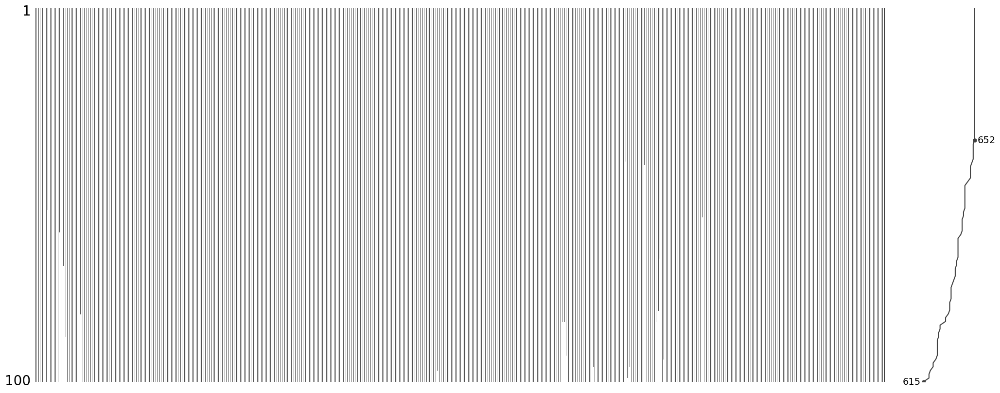

In [8]:
msno.matrix(df)

Several elevation histogram series shows NaN data (32). Incialmente pensé que era por eliminar los ceros de los DEM, pero no es por esta causa. Los valores de cero aparecen en la parte mas alta de las cuencas.

In [9]:
msno.bar(df)

<Axes: >

Se normalizan las series de elevacion para que todas las cuencas tengan una misma escala.

In [10]:
df_n=(df-df.min())/(df.max()-df.min())

<Axes: >

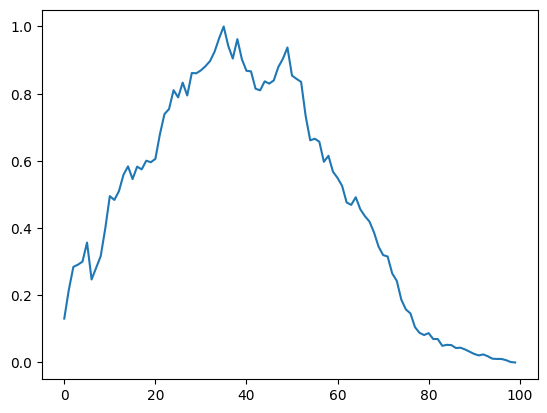

In [11]:
df_n["c_219"].plot(legend=False)

Se llenan los NaN como ceros, eso asegura que todas las series tengan los mismos datos, lo cual es fundamental para comparar las series.

In [12]:
df_n0=df_n.fillna(0)

Se convierte el dataframe con las series de elevación en una lista de series. Para los códigos es mas facil trabajar con las series como listas.

In [13]:
mySeries=[]
for i in np.arange(0,652):
    serie=df_n0[f"c_{i}"].tolist()
    mySeries.append(serie)

Se crea un nuevo dataframe, pero con las series traslocadas para trabajar con los  modelos. Es decir cada columna que representa una serie de 100 valores medios de elevacion para cada subcuenca pasa a ser una fila. Cada columna pasa a convertirse en una variable, es decir la serie de elevacion pasa a convertirse a observaciones con un número de variables igual a la longitud de la serie, en este caso 100 valores promedio de elevación.

**NOTA**= este dataframe df_n0T es lo mismo que trabajar con $mySeries$.

In [14]:
df_n0T=df_n0.T

Se crea una copia del dataframe para ir guardando los resultados espacialmente sin alterar el dataframe original.

In [15]:
cluster=df_n0T.copy()

Se importa el mapa de las subcuencas

In [16]:
cat=gpd.read_file("../Data/subbasins_Ks_zonalStatistic.gpkg")
cat.columns

Index(['OBJECTID', 'Id', 'gridcode', 'Área', 'Nombre', 'ID_CUENCA',
       'hypso_inte', 'area_curva', 'Knickpoint', '_Kscount', '_Ksmean',
       '_Ksmedian', '_Ksstdev', '_Ksmin', '_Ksmax', '_Ksrange', 'geometry'],
      dtype='object')

Se intercepta el mapa de las subcuencas con el dataframe creado. Teniendo en cuenta que el ID_CUENCA corresponde al mismo orden que tiene el archico cluster. Es decir que la posicion 10 en cluster corresponde al ID_CUENCA 10. 

In [17]:
join = cat.set_index('ID_CUENCA').join(cluster.reset_index())
join.columns

Index([  'OBJECTID',         'Id',   'gridcode',       'Área',     'Nombre',
       'hypso_inte', 'area_curva', 'Knickpoint',   '_Kscount',    '_Ksmean',
       ...
                 90,           91,           92,           93,           94,
                 95,           96,           97,           98,           99],
      dtype='object', length=117)

Se crea un mapa solo con las columnas que se necesitan:

In [18]:
join=join.reset_index()
catclu=join[["ID_CUENCA","Nombre","geometry"]]

### Elbow method

In [19]:
from scipy.cluster.hierarchy import dendrogram,linkage
Z=linkage(df_n0T,method='ward',metric='euclidean')

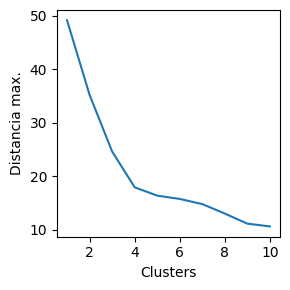

In [20]:
last=Z[-10:,2]
last_rev=last[::-1] #e voltean
idx=np.arange(1,len(last)+1)
plt.figure(figsize=(3,3))
plt.plot(idx,last_rev)
plt.xlabel('Clusters')
plt.ylabel('Distancia max.')
plt.tight_layout()

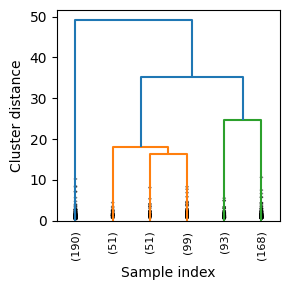

In [21]:
plt.figure(figsize=(3,3))
plt.xlabel('Sample index')
plt.ylabel('Cluster distance');
dendrogram(Z,leaf_rotation=90.,leaf_font_size=8,truncate_mode='lastp',p=6,show_leaf_counts=True,show_contracted=True)
plt.tight_layout()

In [22]:
cluster_count=4

## KMeans

**init: k-means++** : selects initial cluster centroids using sampling based on an empirical probability distribution of the points’ contribution to the overall inertia. This technique speeds up convergence. The algorithm implemented is “greedy k-means++”. It differs from the vanilla k-means++ by making several trials at each sampling step and choosing the best centroid among them.

**n_init: 10** Number of times the k-means algorithm is run with different centroid seeds. The final results is the best output of n_init consecutive runs in terms of inertia. Several runs are recommended for sparse high-dimensional problems

In [28]:
km = KMeans(n_clusters=cluster_count,random_state=1)
kmeans=km.fit_predict(mySeries)
catclu["kmeans"]=kmeans #se debe incorporarar aca al df como numeros, o sino el .map que se utiliza despues para cambiarlo a letras no funciona
print(silhouette_score(mySeries,kmeans))

0.23801440055472525


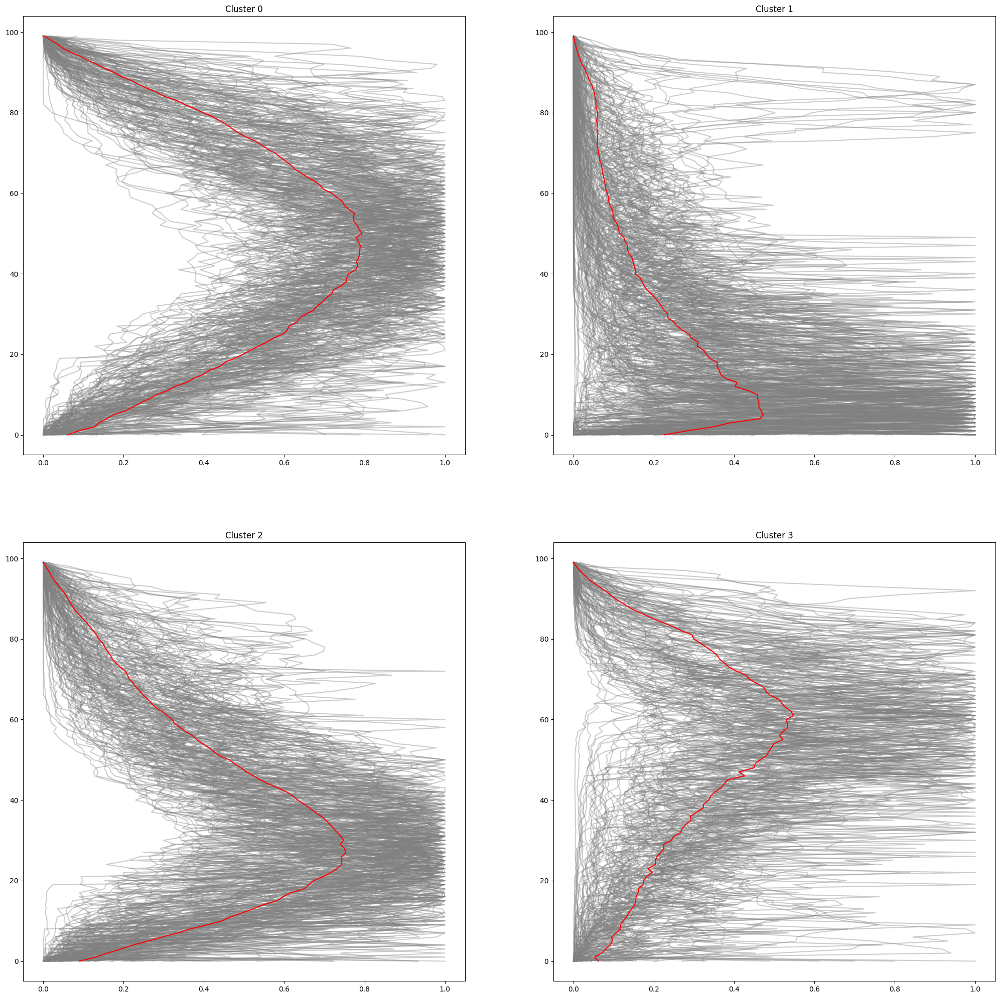

In [29]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=kmeans
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [30]:
Cat={0:'C',1:'A',2:'B',3:'D'}
catclu["kmeans"]=catclu["kmeans"].map(Cat)

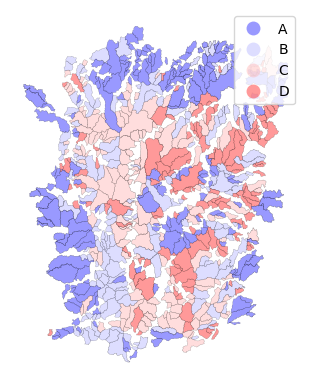

In [31]:
f, ax = plt.subplots()
catclu.plot(column='kmeans',ax=ax,cmap='bwr',alpha=0.4,edgecolor='k',k=10, linewidth=0.2,legend=True)
ax.set_axis_off()

## TimeSeriesKMeans

**metric{“euclidean”, “dtw”, “softdtw”}**: 
Metric to be used for both cluster assignment and barycenter computation. If “dtw”, DBA is used for barycenter computation.

In [184]:
km = TimeSeriesKMeans(n_clusters=cluster_count, metric="dtw",random_state=1) #se demora un poquito 4 min
tskmeans_dtw = km.fit_predict(mySeries)
catclu["tskmeans_dtw"]=tskmeans_dtw
print(silhouette_score(mySeries,tskmeans_dtw))

0.02040406053436134


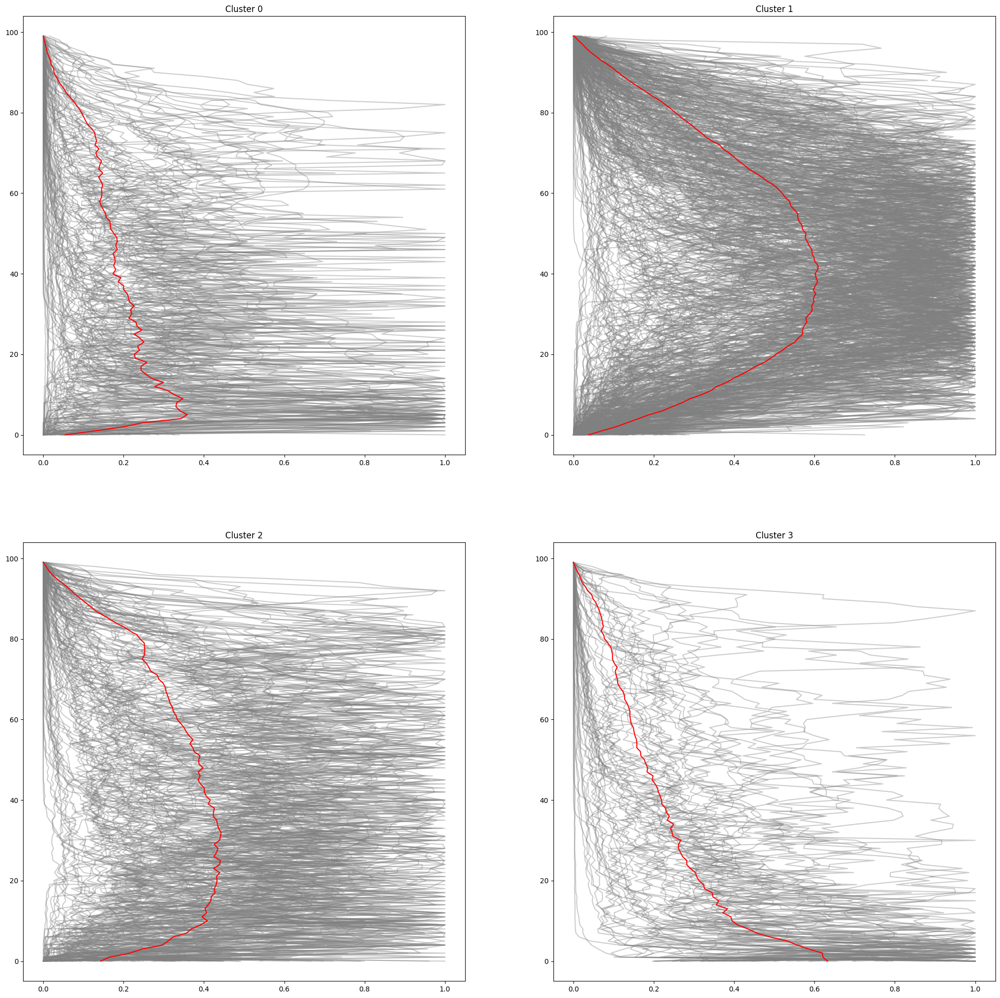

In [185]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=tskmeans_dtw
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [186]:
Cat={0:'B',1:'D',2:'C',3:'A'}
catclu["tskmeans_dtw"]=catclu["tskmeans_dtw"].map(Cat)

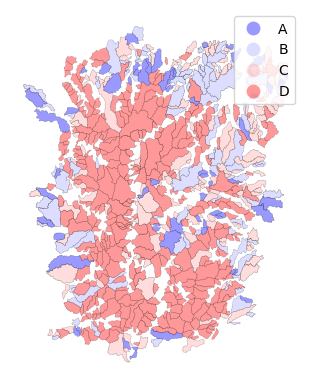

In [187]:
f, ax = plt.subplots()
catclu.plot(column='tskmeans_dtw',ax=ax,cmap='bwr',alpha=0.4,edgecolor='k',k=10, linewidth=0.2,legend=True)
ax.set_axis_off()

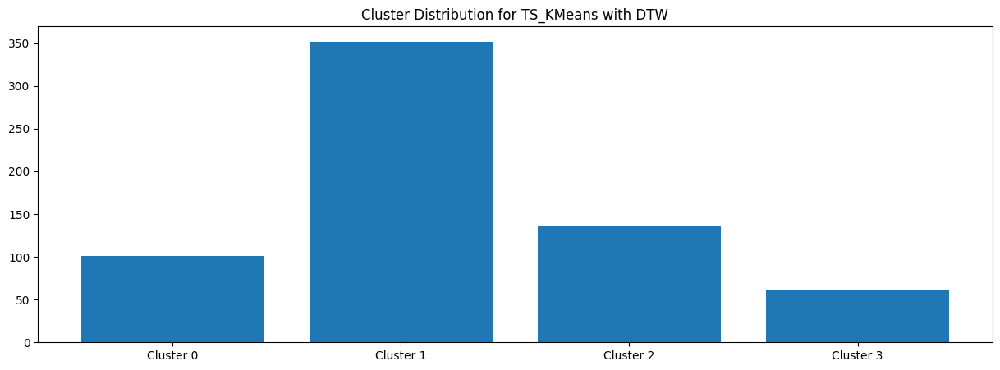

In [188]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for TS_KMeans with DTW")
plt.bar(cluster_n,cluster_c)
plt.show()

In [189]:
km = TimeSeriesKMeans(n_clusters=cluster_count, metric="softdtw",random_state=1) #se demora 7 min
tskmeans_softdtw = km.fit_predict(mySeries)
catclu["tskmeans_softdtw"]=tskmeans_softdtw
print(silhouette_score(mySeries,tskmeans_softdtw))

0.2354326854826116


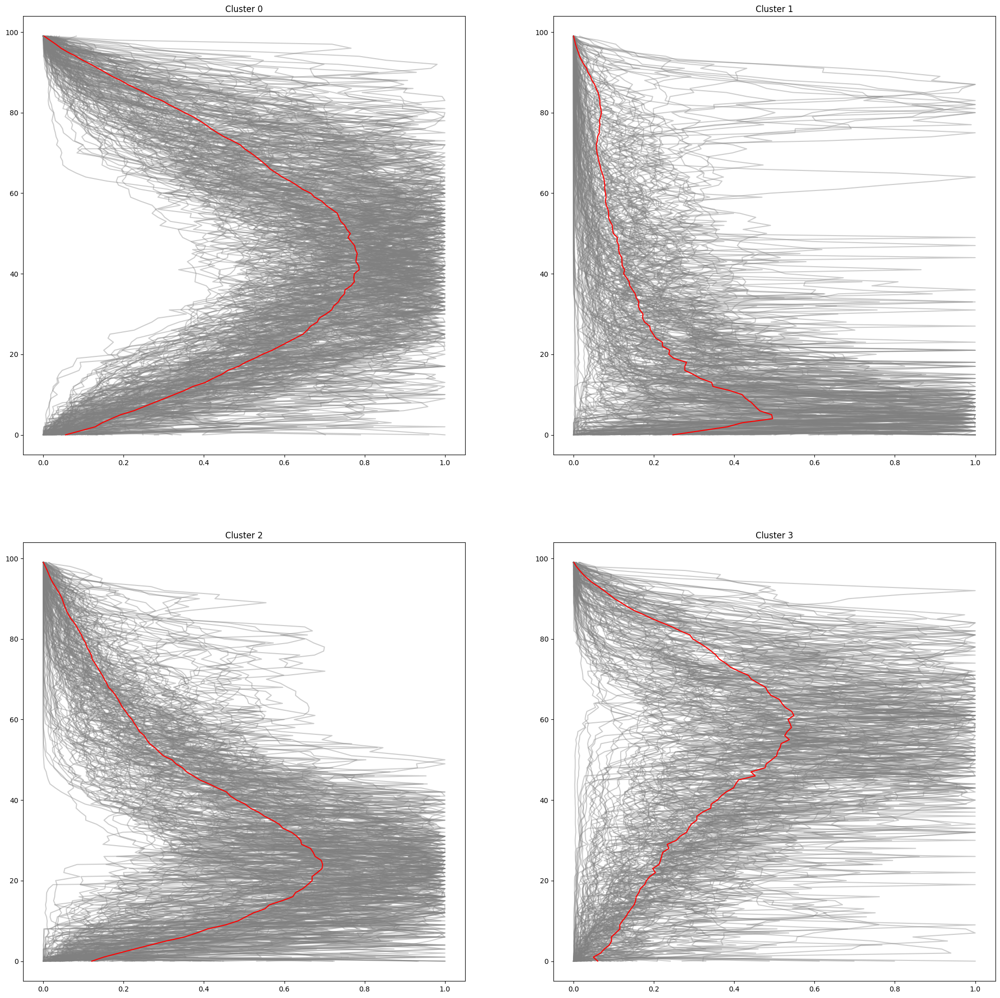

In [190]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=tskmeans_softdtw
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [191]:
Cat={0:'C',1:'A',2:'B',3:'D'}
catclu["tskmeans_softdtw"]=catclu["tskmeans_softdtw"].map(Cat)

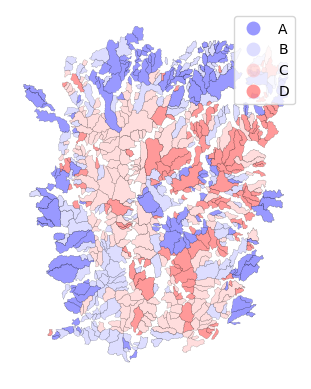

In [192]:
f, ax = plt.subplots()
catclu.plot(column='tskmeans_softdtw',ax=ax,cmap='bwr',alpha=0.4,edgecolor='k',k=10, linewidth=0.2,legend=True)
ax.set_axis_off()

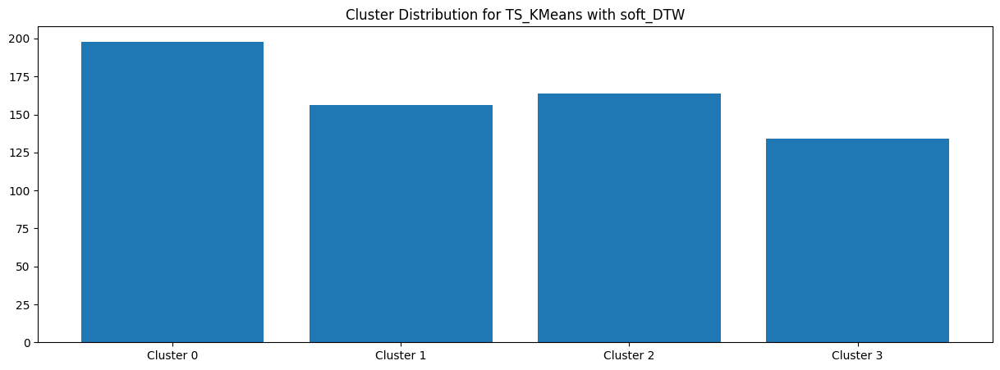

In [193]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for TS_KMeans with soft_DTW")
plt.bar(cluster_n,cluster_c)
plt.show()

## Hierarchical clustering

**Linkage{‘ward’, ‘complete’, ‘average’, ‘single’}**: The linkage criterion determines which distance to use between sets of observation. The algorithm will merge the pairs of cluster that minimize this criterion.

‘ward’ minimizes the variance of the clusters being merged.

‘average’ uses the average of the distances of each observation of the two sets.

‘complete’ or ‘maximum’ linkage uses the maximum distances between all observations of the two sets.

‘single’ uses the minimum of the distances between all observations of the two sets.

Ward's minimum variance criterion minimizes the total within-cluster variance. To implement this method, at each step find the pair of clusters that leads to minimum increase in total within-cluster variance after merging. This increase is a weighted squared distance between cluster centers. At the initial step, all clusters are singletons (clusters containing a single point). To apply a recursive algorithm under this objective function, the initial distance between individual objects must be (proportional to) squared Euclidean distance.

In [194]:
hc=AgglomerativeClustering(n_clusters=cluster_count,affinity='euclidean',linkage='ward')
AgglomerativeClustering=hc.fit_predict(mySeries)
catclu["hc"]=AgglomerativeClustering
print(silhouette_score(mySeries,AgglomerativeClustering))

0.1909417189915262


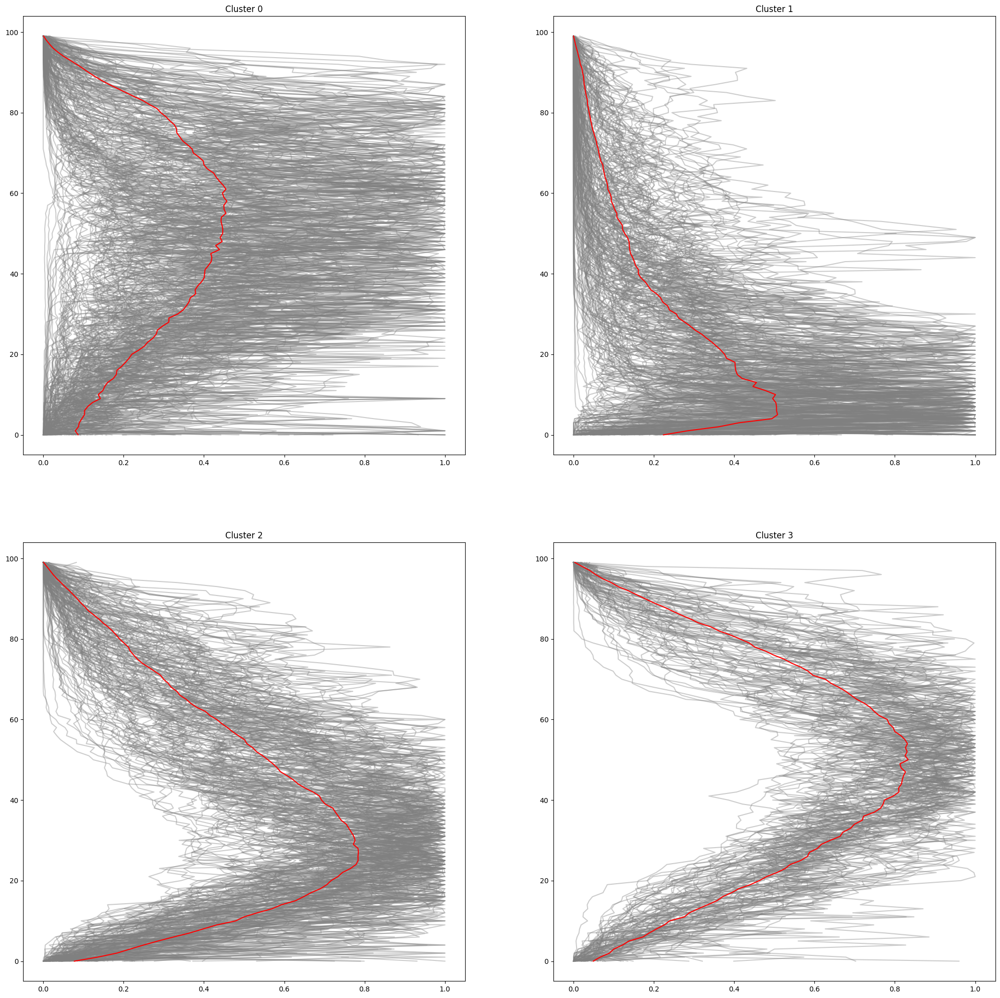

In [195]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=AgglomerativeClustering
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [196]:
Cat={0:'D',1:'A',2:'B',3:'C'}
catclu["hc"]=catclu["hc"].map(Cat)

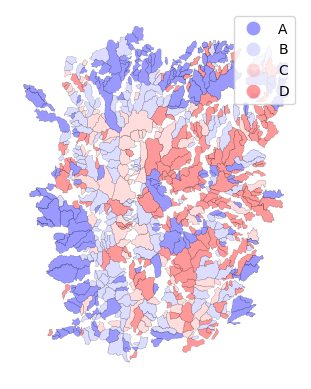

In [197]:
f, ax = plt.subplots()
catclu.plot(column='hc',ax=ax,cmap='bwr',alpha=0.4,edgecolor='k',k=10, linewidth=0.2,legend=True)
ax.set_axis_off()

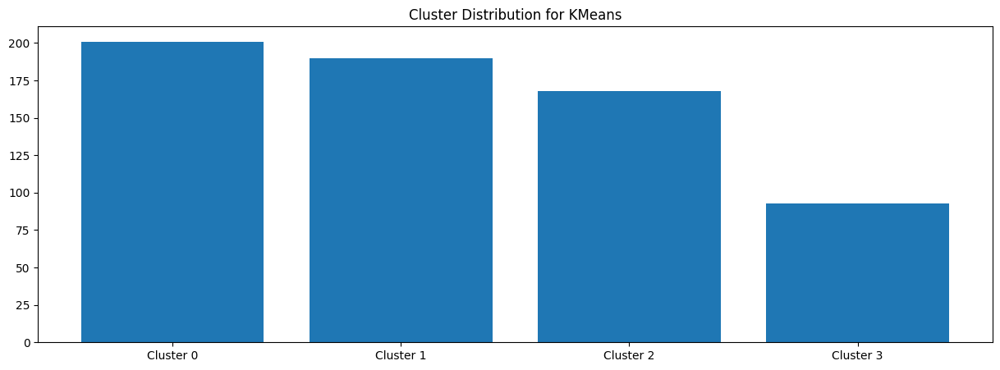

In [198]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for KMeans")
plt.bar(cluster_n,cluster_c)
plt.show()

### KNN

**connectivity**: 
Connectivity matrix. Defines for each sample the neighboring samples following a given structure of the data. This can be a connectivity matrix itself or a callable that transforms the data into a connectivity matrix, such as derived from kneighbors_graph. Default is None, i.e, the hierarchical clustering algorithm is unstructured two sets.

In [199]:
k=1
w = KNN.from_dataframe(catclu, k=k)
df_n0T.columns=df_n0T.columns.astype(str)
model = AgglomerativeClustering(linkage='ward',connectivity=w.sparse,n_clusters=cluster_count)
knn_1=model.fit_predict(df_n0T)
catclu['knn_1'] = knn_1
print(silhouette_score(mySeries,knn_1))

0.175676603078996


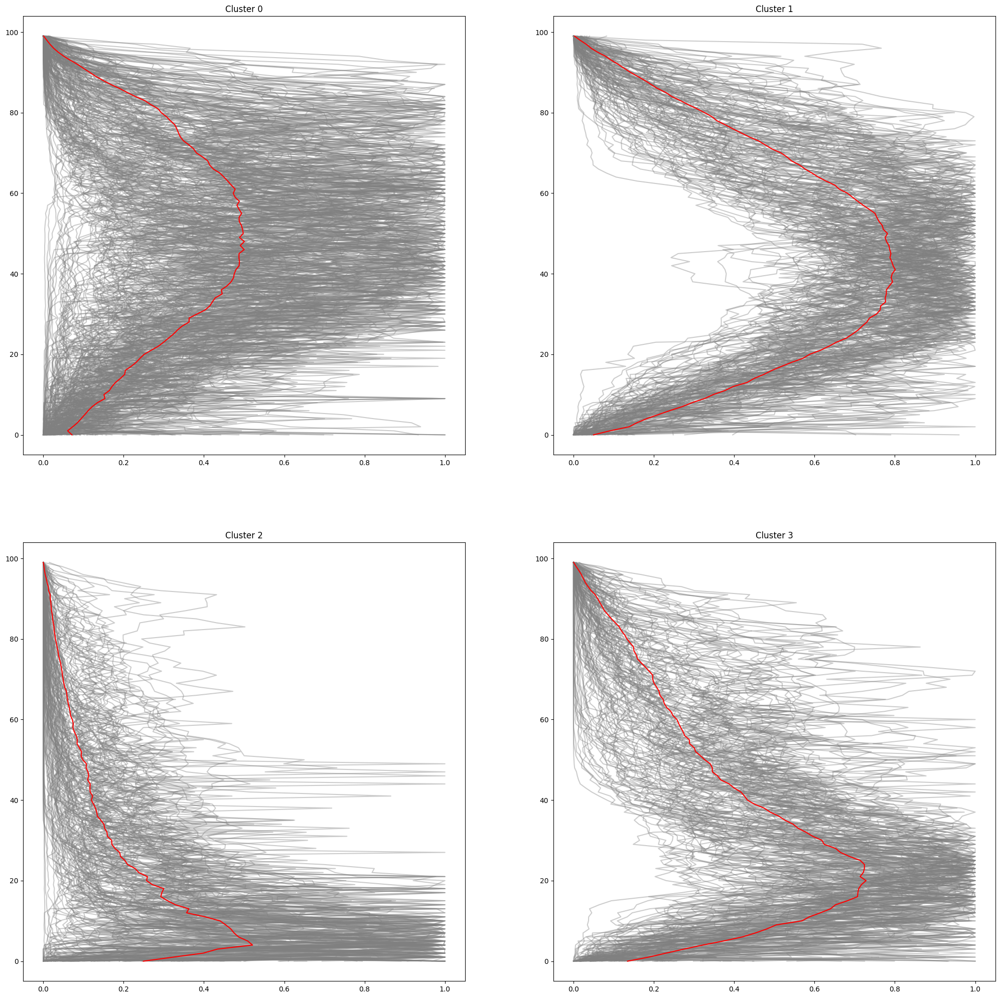

In [200]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=knn_1
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [201]:
Cat={0:'D',1:'C',2:'A',3:'B'}
catclu["knn_1"]=catclu["knn_1"].map(Cat)

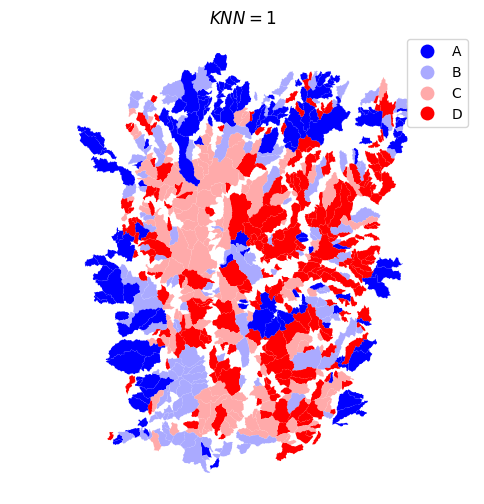

In [202]:
f, ax = plt.subplots(1, figsize=(6, 6))
catclu.plot(column='knn_1',legend=True,ax=ax,cmap='bwr')
ax.set_axis_off()
plt.axis('equal')
plt.title(f'$KNN={k}$')
plt.show()

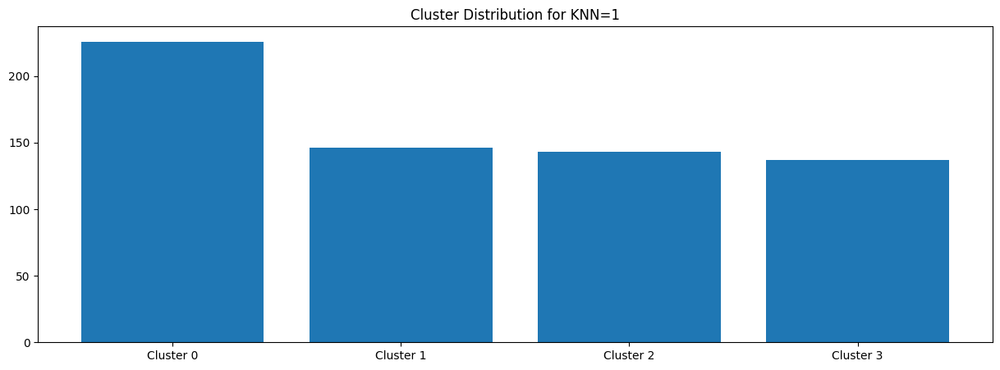

In [203]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for KNN=1")
plt.bar(cluster_n,cluster_c)
plt.show()

In [204]:
k=2
w = KNN.from_dataframe(catclu, k=k)
df_n0T.columns=df_n0T.columns.astype(str)
model = AgglomerativeClustering(linkage='ward',connectivity=w.sparse,n_clusters=cluster_count)
knn_2=model.fit_predict(df_n0T)
catclu['knn_2'] = knn_2
print(silhouette_score(mySeries,knn_2))

-0.17355189049389338


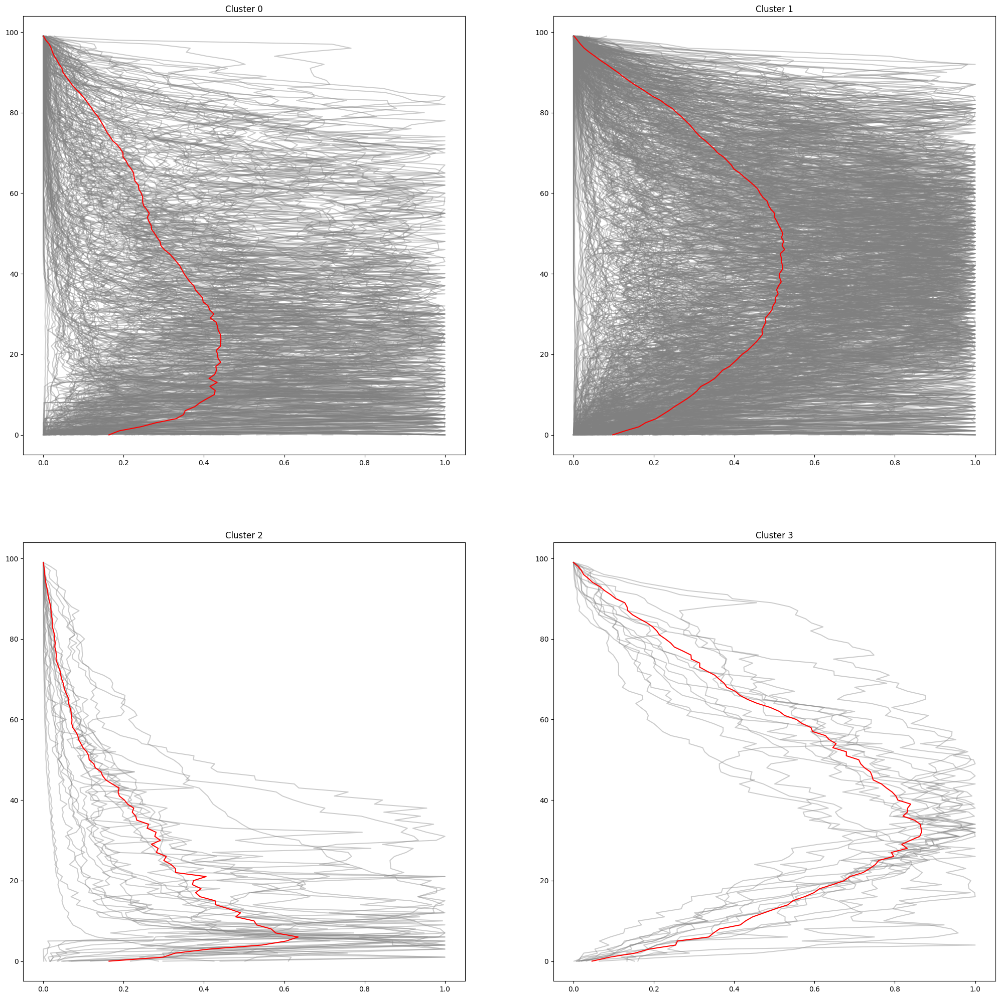

In [205]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=knn_2
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [206]:
Cat={0:'B',1:'D',2:'A',3:'C'}
catclu["knn_2"]=catclu["knn_2"].map(Cat)

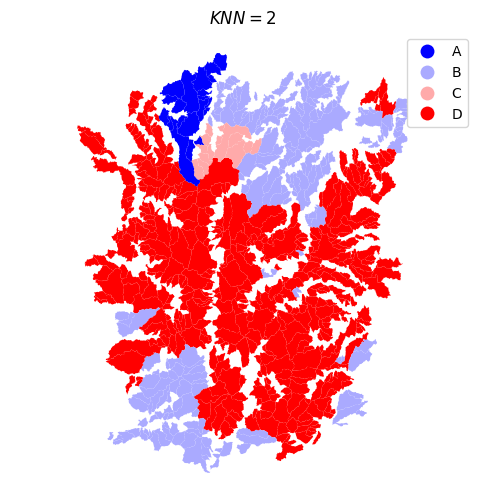

In [207]:
f, ax = plt.subplots(1, figsize=(6, 6))
catclu.plot(column='knn_2',legend=True,ax=ax,cmap='bwr')
ax.set_axis_off()
plt.axis('equal')
plt.title(f'$KNN={k}$')
plt.show()

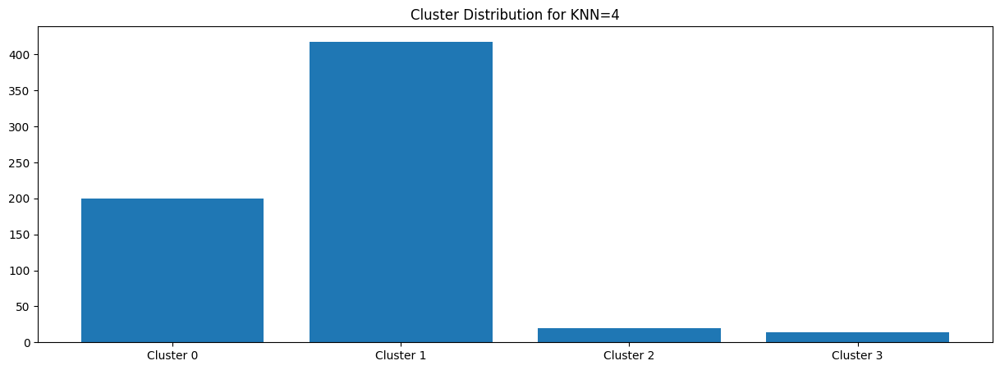

In [208]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for KNN=4")
plt.bar(cluster_n,cluster_c)
plt.show()

In [209]:
k=4
w = KNN.from_dataframe(catclu, k=k)
df_n0T.columns=df_n0T.columns.astype(str)
model = AgglomerativeClustering(linkage='ward',connectivity=w.sparse,n_clusters=4)
knn_4=model.fit_predict(df_n0T)
catclu['knn_4'] = knn_4
print(silhouette_score(mySeries,knn_4))

0.030353834977492535


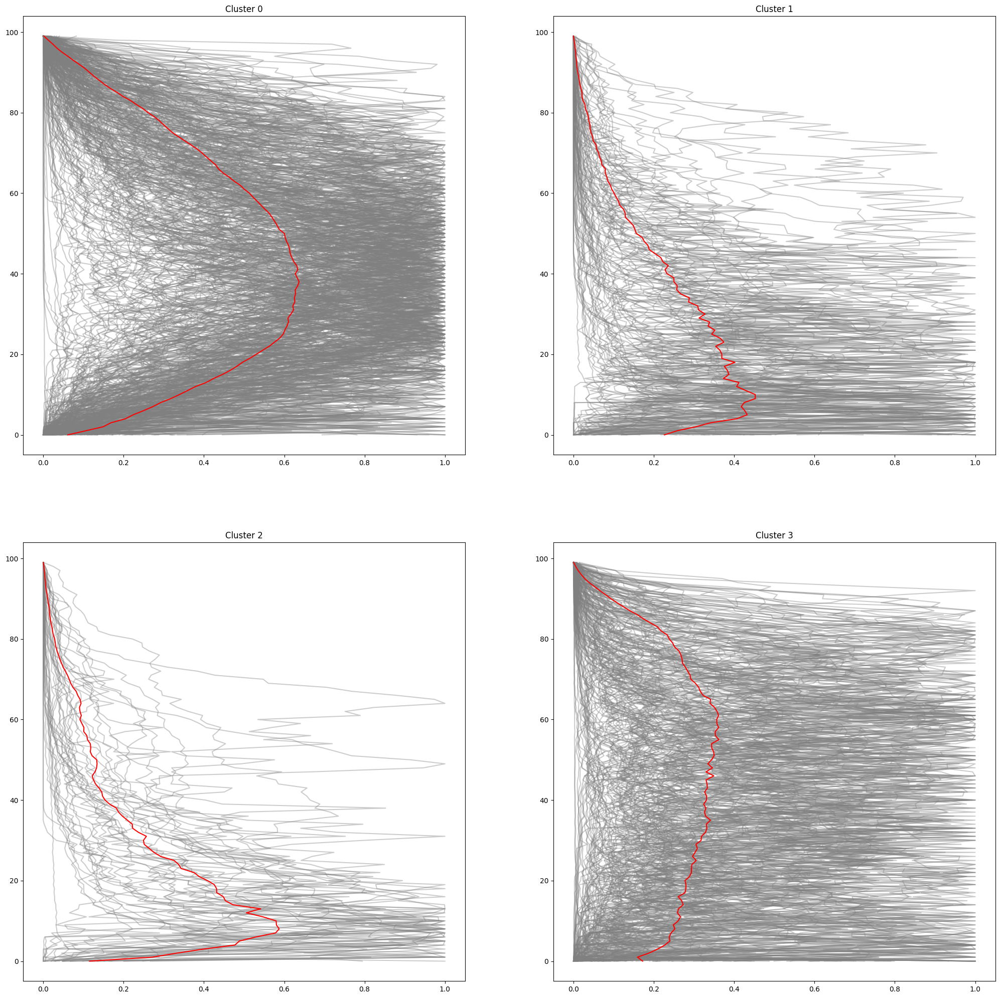

In [210]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=knn_4
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [211]:
Cat={0:'C',1:'B',2:'A',3:'D'}
catclu["knn_4"]=catclu["knn_4"].map(Cat)

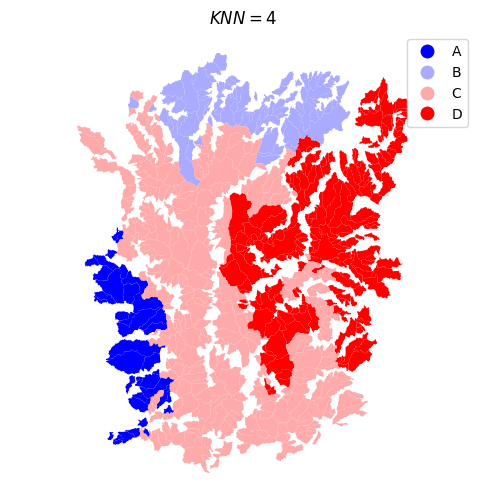

In [212]:
f, ax = plt.subplots(1, figsize=(6, 6))
catclu.plot(column='knn_4',legend=True,ax=ax,cmap='bwr')
ax.set_axis_off()
plt.axis('equal')
plt.title(f'$KNN={k}$')
plt.show()

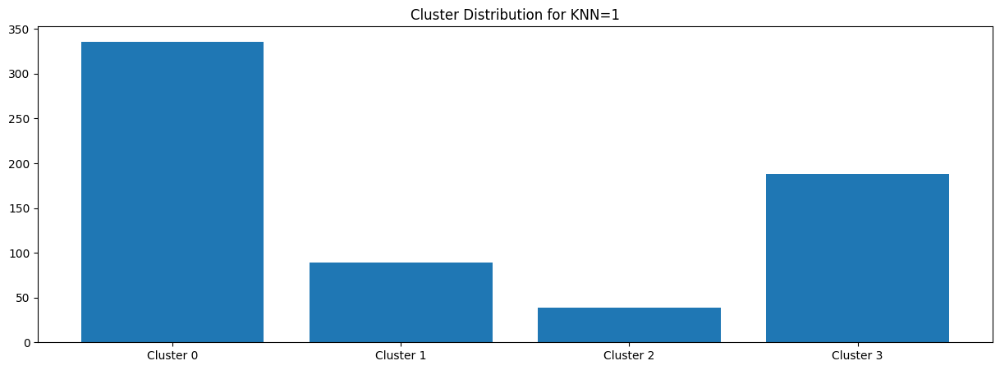

In [213]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for KNN=1")
plt.bar(cluster_n,cluster_c)
plt.show()

In [214]:
k=10
w = KNN.from_dataframe(catclu, k=k)
df_n0T.columns=df_n0T.columns.astype(str)
model = AgglomerativeClustering(linkage='ward',connectivity=w.sparse,n_clusters=4)
knn_10=model.fit_predict(df_n0T)
catclu['knn_10'] = knn_10
print(silhouette_score(mySeries,knn_10))

0.05502610109943742


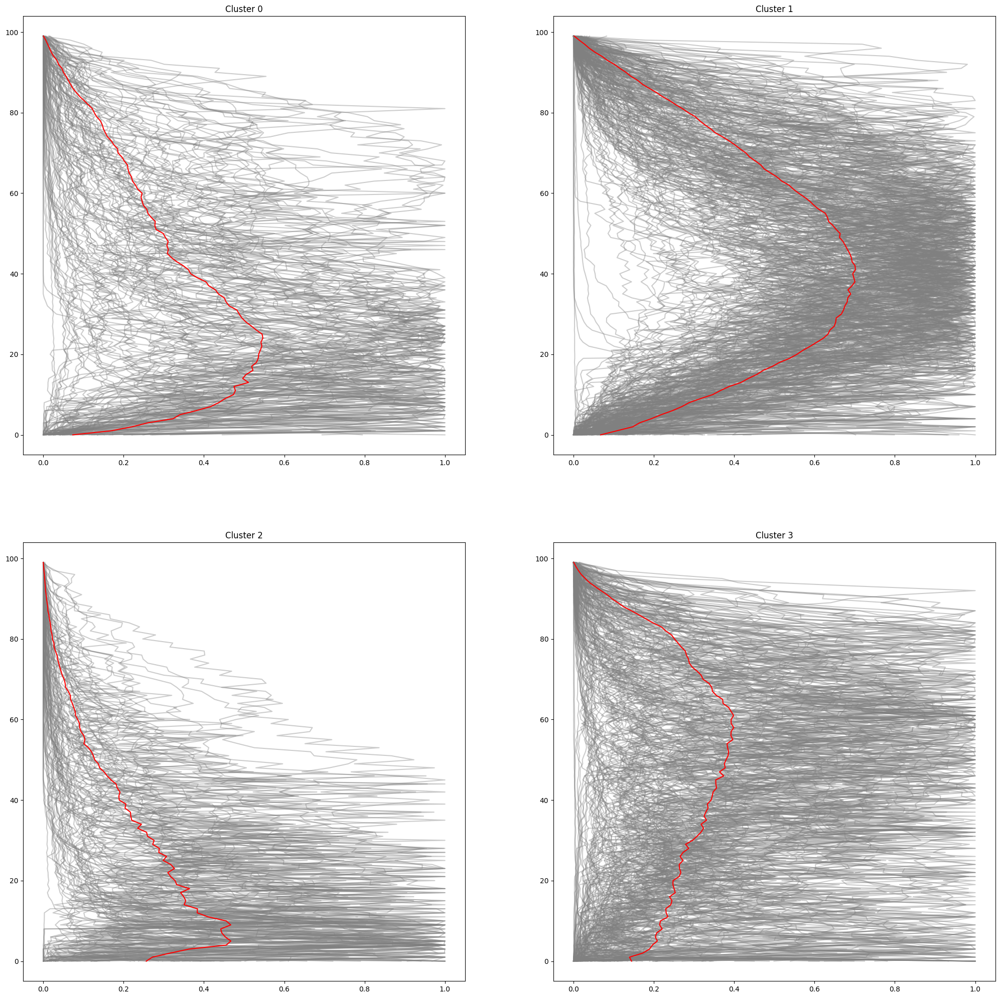

In [215]:
fig, axs = plt.subplots(2,2,figsize=(25,25))
labels=knn_10
row_i=0
column_j=0
for label in set(labels):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i, column_j].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.4)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i, column_j].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c="red")
    axs[row_i, column_j].set_title(f"Cluster {label}")
    column_j+=1
    if column_j%2 == 0:
        row_i+=1
        column_j=0
        
plt.show()

In [216]:
Cat={0:'B',1:'C',2:'A',3:'D'}
catclu["knn_10"]=catclu["knn_10"].map(Cat)

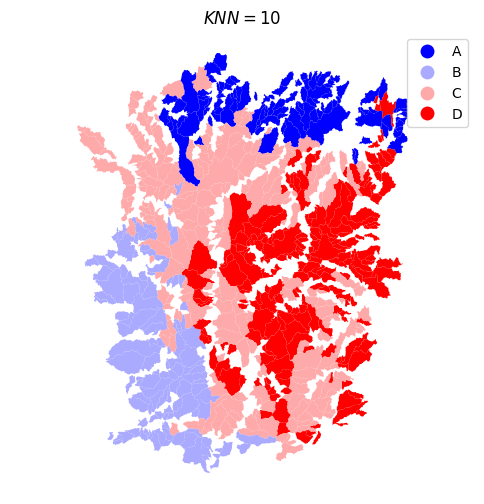

In [217]:
f, ax = plt.subplots(1, figsize=(6, 6))
catclu.plot(column='knn_10',legend=True,ax=ax,cmap='bwr')
ax.set_axis_off()
plt.axis('equal')
plt.title(f'$KNN={k}$')
plt.show()

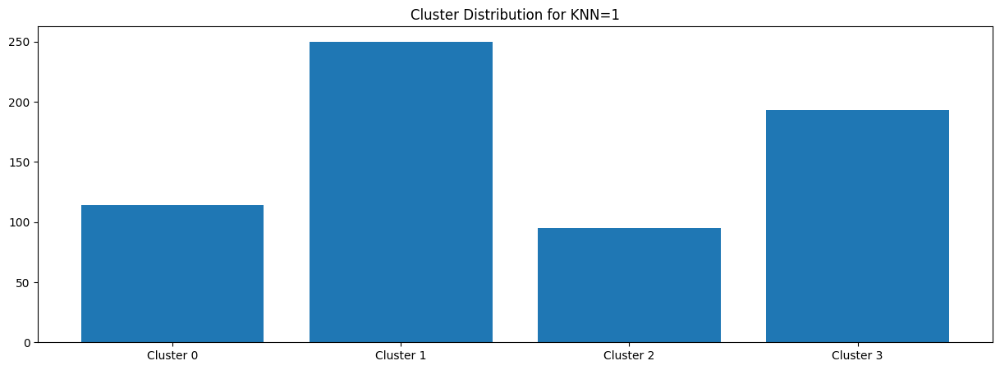

In [218]:
cluster_c = [len(labels[labels==i]) for i in range(cluster_count)]
cluster_n = ["Cluster "+str(i) for i in range(cluster_count)]
plt.figure(figsize=(15,5))
plt.title("Cluster Distribution for KNN=1")
plt.bar(cluster_n,cluster_c)
plt.show()

In [185]:
catclu.to_file("../Data/catchment_cluster.gpkg", driver="GPKG")

### Landslides

In [33]:
recent= gpd.read_file("../Data/recent2_elev.gpkg")
recent_re=recent.to_crs(32618)
recent_re.columns

Index(['Name', 'description', 'timestamp', 'begin', 'end', 'altitudeMode',
       'tessellate', 'extrude', 'visibility', 'drawOrder', 'icon', 'date',
       'source', 'elevation1', 'geometry'],
      dtype='object')

In [34]:
ancient= gpd.read_file("../Data/relict_elevation.gpkg")
ancient_re=ancient.to_crs(32618)
ancient_re.columns

Index(['Name', 'elevation1', 'geometry'], dtype='object')

In [35]:
elevation=gpd.read_file("../Data/Elevation_MinMax_catchemnts.gpkg")
elevation.columns

Index(['ID_CUENCA', 'Nombre', 'kmeans', 'tskmeans_d', 'tskmeans_s', 'knn_1',
       'knn_2', 'knn_4', 'knn_10', 'hc', 'elevmin', 'elevmax', 'geometry'],
      dtype='object')

In [36]:
rec_cat = gpd.sjoin(recent_re, catclu, how="inner")
rec_cat.tail(2)

,Name,description,timestamp,begin,end,altitudeMode,tessellate,extrude,visibility,drawOrder,icon,date,source,elevation1,geometry,index_right,ID_CUENCA,Nombre,kmeans
12851,NaN,NaN,NaT,NaT,NaT,NaN,-1,0,-1,NaN,NaN,02102020,My Places — Temporary Places,1971.0,POINT Z (367159.636 657299.231 0.000),243,243,Río San Pablo,C
12927,NaN,NaN,NaT,NaT,NaT,NaN,-1,0,-1,NaN,NaN,02102020,My Places — Temporary Places,1733.0,POINT Z (350986.908 789539.370 0.000),525,525,Río Tasidó,C


In [37]:
rec_A=rec_cat[rec_cat["kmeans"]=="A"]
rec_B=rec_cat[rec_cat["kmeans"]=="B"]
rec_C=rec_cat[rec_cat["kmeans"]=="C"]
rec_D=rec_cat[rec_cat["kmeans"]=="D"]

In [38]:
rel_cat = gpd.sjoin(ancient_re, catclu, how="inner")
rel_cat.tail(2)

,Name,elevation1,geometry,index_right,ID_CUENCA,Nombre,kmeans
220,K205,1789.0,POINT Z (440332.758 579046.568 1767.822),382,382,Río Tareas,A
221,K206,755.0,POINT Z (452907.806 809909.132 747.913),417,417,Quebrada La Siberia,B


In [39]:
rel_A=rel_cat[rel_cat["kmeans"]=="A"]
rel_B=rel_cat[rel_cat["kmeans"]=="B"]
rel_C=rel_cat[rel_cat["kmeans"]=="C"]
rel_D=rel_cat[rel_cat["kmeans"]=="D"]

#### Normalizar series de deslizamientos

In [245]:
normal=[]
for i in rec_A.index.values:
    x=(rec_A.loc[i,'elevation1']-elevation.loc[rec_A.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rec_A.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rec_A.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rec_A["normal"]=normal

In [246]:
normal=[]
for i in rec_B.index.values:
    x=(rec_B.loc[i,'elevation1']-elevation.loc[rec_B.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rec_B.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rec_B.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rec_B["normal"]=normal

In [247]:
normal=[]
for i in rec_C.index.values:
    x=(rec_C.loc[i,'elevation1']-elevation.loc[rec_C.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rec_C.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rec_C.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rec_C["normal"]=normal

In [248]:
normal=[]
for i in rec_D.index.values:
    x=(rec_D.loc[i,'elevation1']-elevation.loc[rec_D.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rec_D.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rec_D.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rec_D["normal"]=normal

In [249]:
normal=[]
for i in rel_A.index.values:
    x=(rel_A.loc[i,'elevation1']-elevation.loc[rel_A.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rel_A.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rel_A.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rel_A["normal"]=normal

In [250]:
normal=[]
for i in rel_B.index.values:
    x=(rel_B.loc[i,'elevation1']-elevation.loc[rel_B.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rel_B.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rel_B.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rel_B["normal"]=normal

In [251]:
normal=[]
for i in rel_C.index.values:
    x=(rel_C.loc[i,'elevation1']-elevation.loc[rel_C.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rel_C.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rel_C.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rel_C["normal"]=normal

In [252]:
normal=[]
for i in rel_D.index.values:
    x=(rel_D.loc[i,'elevation1']-elevation.loc[rel_D.loc[i,'ID_CUENCA'],"elevmin"])/(elevation.loc[rel_D.loc[i,'ID_CUENCA'],"elevmax"]-elevation.loc[rel_D.loc[i,'ID_CUENCA'],"elevmin"])
    normal.append(x)
rel_D["normal"]=normal

In [261]:
labels=catclu["kmeans"]
set(labels)

{'A', 'B', 'C', 'D'}

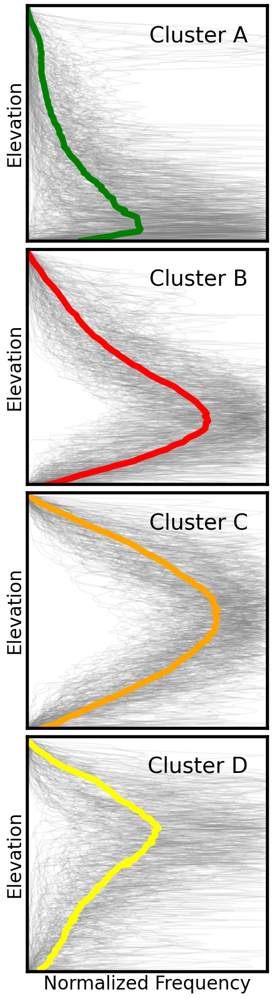

In [43]:
fig, axs = plt.subplots(4,1,figsize=(5,18))
#Cat={0:'C',1:'A',2:'B',3:'D'}
labels=catclu["kmeans"]
row_i=0
z=0
c=['green','red','orange','yellow']
for label in sorted(set(labels)):
    clustering = []
    for i in np.arange(len(labels)):
            if(labels[i]==label):
                axs[row_i].plot(mySeries[i],np.arange(0,100),c="gray",alpha=0.1)
                clustering.append(mySeries[i])
    if len(clustering) > 0:
        axs[row_i].plot(np.average(np.vstack(clustering),axis=0),np.arange(0,100),c=c[z],linewidth=8,label=f"Cluster {label}")
        z=z+1
    axs[row_i].set_ylim(0,100)
    axs[row_i].set_xlim(0,1)
    axs[row_i].set_xticks([])
    axs[row_i].set_yticks([])
    axs[row_i].legend(ncol=1,loc="upper right",prop={'size': 28},frameon=False)
    leg=axs[row_i].get_legend()
    leg.legendHandles[0].set_alpha(0)
    plt.setp(axs[row_i].spines.values(), lw=4)
    row_i+=1
"""
bins=10

ax0 = axs[0].twinx()
ax0.hist(rel_A["normal"],orientation='horizontal',color='black',alpha=0.8,bins=bins,label="Pre-historic",weights=np.full(len(rel_A["normal"]), 1/len(rel_A["normal"])))
ax0.hist(rec_A["normal"],orientation='horizontal',color='red',alpha=0.5,bins=bins,label="Recent",weights=np.full(len(rec_A["normal"]), 1/len(rec_A["normal"])))
ax0.set_yticks([])

ax1 = axs[1].twinx()
ax1.hist(rel_B["normal"],orientation='horizontal',color='black',alpha=0.8,bins=bins,weights=np.full(len(rel_B["normal"]), 1/len(rel_B["normal"])))
ax1.hist(rec_B["normal"],orientation='horizontal',color='red',alpha=0.5,bins=bins,weights=np.full(len(rec_B["normal"]), 1/len(rec_B["normal"])))
ax1.set_yticks([])

ax2 = axs[2].twinx()
ax2.hist(rel_C["normal"],orientation='horizontal',color='black',alpha=0.8,bins=bins,label="Pre-historic",weights=np.full(len(rel_C["normal"]), 1/len(rel_C["normal"])))
ax2.hist(rec_C["normal"],orientation='horizontal',color='red',alpha=0.5,bins=bins,label="Recent",weights=np.full(len(rec_C["normal"]), 1/len(rec_C["normal"])))
ax2.set_yticks([])

ax3 = axs[3].twinx()
ax3.hist(rel_D["normal"],orientation='horizontal',color='black',alpha=0.8,label="Pre-historic",bins=bins,weights=np.full(len(rel_D["normal"]), 1/len(rel_D["normal"])))
ax3.hist(rec_D["normal"],orientation='horizontal',color='red',alpha=0.5,label="Recent",bins=bins,weights=np.full(len(rec_D["normal"]), 1/len(rec_D["normal"])))
ax3.set_yticks([])
"""
axs[3].set_xlabel('Normalized Frequency',fontsize=24)
axs[0].set_ylabel('Elevation',fontsize=24)
axs[1].set_ylabel('Elevation',fontsize=24)
axs[2].set_ylabel('Elevation',fontsize=24)
axs[3].set_ylabel('Elevation',fontsize=24)
fig.subplots_adjust(wspace=0.02, hspace=0.02)

#ax[3].legend(loc="lower right",frameon=False,prop={'size': 16})
fig.tight_layout() 

plt.savefig("../Figures/fig7B.png", bbox_inches='tight',dpi=500);